<a href="https://colab.research.google.com/github/skc46/Microstructure_recognition/blob/master/Final_project_team_L.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Using Computer Vision to Study the Microstructure of Heusler Alloys

## Problem Statement

Among many other methods, the micrograph analysis, taken by optical microscope, is a fast and cost-effective way to characterize the phase-stability of a material. Micrographs provide useful information about the processes and mechanisms used for microstructural formation, material behavior and performance. By observing the different contrasts seen in the microstructure image, predictions can be made about the phase-stability. Generally, the different phase compositions appear to have different contrasts. However, in an experimental optical micrograph, different attributes such as polishing artifacts, scratches, voids, and circular beams generate different contrasts as well making it a challenging task to generate relevant microstructural analysis of the phase stability. This can cause an uphill battle even for an experienced researcher with many years of background in material research. Instead, energy dispersive X-ray spectroscopy (EDS) can be used to determine if the different contrast regions actually have different compositions. EDS is completed on a case-by-case basis which requires more manual efforts and higher cost. 

While the material characterization and analysis requires a deep understanding of particular materials or microstructures, the use of computer vision (CV) and Machine Learning (ML) can be used to replicate human expertise leading to less manual efforts and lower cost. 


## Quick Description of the ML Problem

Use Convolutional neural network (CNN) to predict if an optical micrograph of Heusler alloy is single-phase or multi-phase based on the contrast from the micrograph while also disregarding the different artifacts present in the image.

## Importing Necessary Library

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.image import imread
from numpy import asarray, save
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
import cv2
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import random

import tensorflow
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D, BatchNormalization, GlobalAveragePooling2D, GlobalAvgPool2D
from tensorflow.keras.optimizers import Adam,Adamax
from sklearn.model_selection import GridSearchCV
from tensorflow.keras import models, losses, Model, layers


#### Install visualkeras for visualizing the CNN architecture

In [ ]:
pip install visualkeras

In [ ]:
import visualkeras

## Data Preparation

Load the drive helper and mount it to get files located in google drive directory. Notice that it will prompt authorization, you will need to provide the authentical key that you can get by following the link that appears.

In [7]:
from google.colab import drive
drive.mount('/gdrive')
%cd /gdrive

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).
/gdrive


Changing to directory where the images are stored. Note that it will automatically connect to the location where the images are stored so that you can directly access them. No further actions are required other than running this cell.

In [ ]:
cd ./.shortcut-targets-by-id/1xFGEqBKgJLVXi-vnrHybhyDeskgEJrUg/project_images/

In [1]:
# skip this cell
#cd ./MyDrive/machine_learning/project_images/


### Data augmentation steps

You can skip these steps, if you don't want to do data augmentation.

In [ ]:
# auto-augmentation
gen = ImageDataGenerator(rotation_range=20, shear_range=0.1, zoom_range=0.20, channel_shift_range=10, horizontal_flip=True)

In [ ]:
single_x = []

IMG_SIZE = 299  # iamge size we want

def create_training_data():
        path = os.path.join(DATADIR, 'Single-Phase')
        for img in os.listdir(path):
            img_array = cv2.imread(os.path.join(path,img), cv2.IMREAD_COLOR)
            new_array = cv2.resize(img_array, (IMG_SIZE, IMG_SIZE))
            single_x.append(new_array)
            
create_training_data()  

In [ ]:
x = np.array(single_x)

In [ ]:
mkdir Augmented_single

In [ ]:
i = 0
for batch in gen.flow(x, batch_size=400, save_to_dir='Augmented_single', save_prefix='aug', save_format='jpg'):
  i +=1
  if i >5:
    break

### Create training dataset
Please note this takes a while to go through each images.

In [197]:
DATADIR = "./Train"
CATEGORIES = ['Multiple-Phase', 'Single-Phase']

training_data = []

IMG_SIZE = 299  # image size we want

def create_training_data():
    for category in CATEGORIES:
        path = os.path.join(DATADIR, category)
        class_num = CATEGORIES.index(category)
        for img in os.listdir(path):
            im = cv2.imread(os.path.join(path,img))
            #im = cv2.imread(os.path.join(path,img), cv2.IMREAD_COLOR) # for BGR representation and also cv2.IMREAD_GRAYSCALE for grayscale  
            img_array = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)   # if using BGR and Grayscale comment this
            new_array = cv2.resize(img_array, (IMG_SIZE, IMG_SIZE))
            training_data.append([new_array, class_num])
            
create_training_data()            


In [198]:
# data shuffling
random.shuffle(training_data)

#### Creating feature matrix and label for training data

In [199]:
photos = []
labels = []

for features, label in training_data:
    photos.append(features)
    labels.append(label)
    
X_train= np.array(photos).reshape(-1, IMG_SIZE, IMG_SIZE, 3)  # for gray scale 1, for RBG change it to 3   
y_train = np.array(labels) 

In [200]:
print(X_train.shape, y_train.shape)

(1107, 299, 299, 3) (1107,)


#### If you prefer other ways of creating image array, you can use this cell.Otherwise skip it.

In [ ]:
# other ways of creating image arrays
DATADIR = "./Train"
CATEGORIES = ['Multiple-Phase', 'Single-Phase']

training_data = []

def create_training_data():
    for category in CATEGORIES:
        path = os.path.join(DATADIR, category)
        class_num = CATEGORIES.index(category)
        for img in os.listdir(path):
            #img_array = imread(os.path.join(path,img))
            photo = load_img(os.path.join(path,img), target_size=(256,256,3))
            photo= img_to_array(photo)
            training_data.append([photo, class_num])
            
create_training_data()  

random.shuffle(training_data)

photos = []
labels = []

for features, label in training_data:
    photos.append(features)
    labels.append(label)
    
X_train= np.array(photos).reshape(-1, IMG_SIZE, IMG_SIZE, 3)  # for gray scale 1, for RBG change it to 3   
y_train = np.array(labels) 

### Creating Test data

In [201]:
DATADIR = "./Test"
CATEGORIES = ['Multiple-Phase', 'Single-Phase']

test_data = []


def create_test_data():
    for category in CATEGORIES:
        path = os.path.join(DATADIR, category)
        class_num = CATEGORIES.index(category)
        for img in os.listdir(path):
            im = cv2.imread(os.path.join(path,img))
            img_array = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
            new_array = cv2.resize(img_array, (IMG_SIZE, IMG_SIZE))
            test_data.append([new_array, class_num])
            
create_test_data()  

random.shuffle(test_data)


In [202]:
# Creating feature matrix and labels
feature_test = []
labels_test = []


for features, label in test_data:
    feature_test.append(features)
    labels_test.append(label)
    
X_test= np.array(feature_test).reshape(-1, IMG_SIZE, IMG_SIZE, 3)  # for gray scale 1, for RBG change it to 3 
y_test = np.array(labels_test)

In [203]:
X_test.shape

(176, 299, 299, 3)

#### Can skip this, if not using other ways of creating image arrays as discussed for training set.

In [ ]:
# other ways of creating image arrays
DATADIR = "./Test"
CATEGORIES = ['Multiple-Phase', 'Single-Phase']

test_data = []

def create_test_data():
    for category in CATEGORIES:
        path = os.path.join(DATADIR, category)
        class_num = CATEGORIES.index(category)
        for img in os.listdir(path):
            #img_array = imread(os.path.join(path,img))
            photo = load_img(os.path.join(path,img), target_size=(256,256,3))
            photo= img_to_array(photo)
            test_data.append([photo, class_num])
            
create_test_data()  

random.shuffle(test_data)

# Creating feature matrix and labels
feature_test = []
labels_test = []


for features, label in test_data:
    feature_test.append(features)
    labels_test.append(label)
    
X_test= np.array(feature_test).reshape(-1, IMG_SIZE, IMG_SIZE, 3)  # for gray scale 1, for RBG change it to 3 
y_test = np.array(labels_test)


### Scaling dataset

In [ ]:
# scaling the train and test data pixel values
X_train_scaled = X_train/ 255.

X_test_scaled = X_test/ 255.

## Visualizing a few images

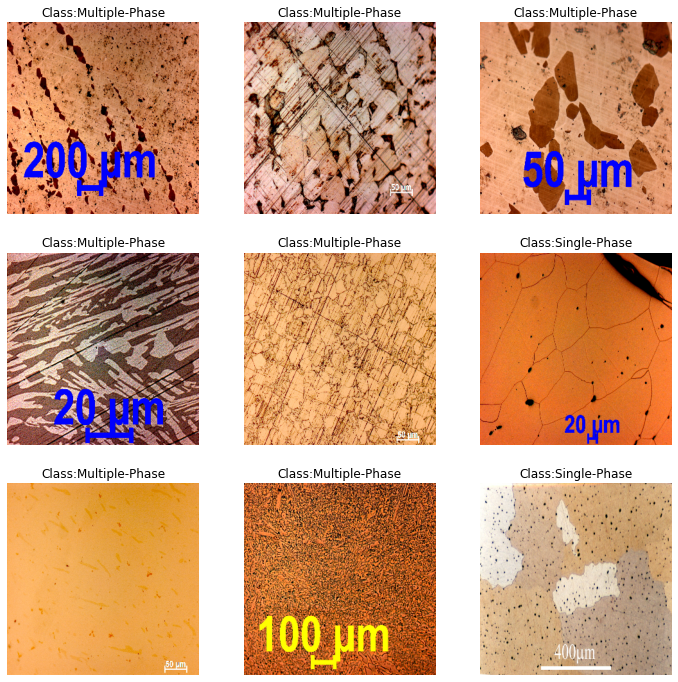

In [ ]:
# let's visualized test images
plt.figure(figsize=(12,12))
index=0
for img,lbl in zip(X_train[:9,],y_train[:9,]):
    index +=1
    plt.subplot(3,3,index)
    plt.imshow(img)
    plt.title("Class:{}".format(CATEGORIES[lbl]))
    plt.axis("off")
plt.show()

In [17]:
import tensorflow as tf
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)

    except RuntimeError as e:
        print(e)

Physical devices cannot be modified after being initialized


## Starting with our manual model

In [ ]:
from collections import defaultdict
model = Sequential([
        Conv2D(32, 5, activation='relu', padding='same', input_shape=X_train_scaled.shape[1:]),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(64, 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(128, 3, activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(256, 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(256, 3, activation='relu', padding='same'),
        BatchNormalization(),
        GlobalAveragePooling2D(),
        Flatten(),
        Dense(1024, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(256, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(1, activation='sigmoid' )
        ])
        
#model.summary()

# Architecture visualuzation; make sure visualkeras is installed and imported correctly
color_map = defaultdict(dict)
color_map[Conv2D]['fill'] = 'orange'
color_map[MaxPooling2D]['fill'] = 'green'
color_map[BatchNormalization]['fill'] = 'red'
color_map[GlobalAveragePooling2D]['fill'] = 'gray'
color_map[Flatten]['fill'] = 'blue'
color_map[Dense]['fill']='black'
color_map[Dropout]['fill']='magenta'
visualkeras.layered_view(model, color_map = color_map).show()
visualkeras.layered_view(model, color_map = color_map, to_file='cnn.png')

### Hyperparameter Tuning

#### Tuning Optimizer selection

In [ ]:
tensorflow.keras.backend.clear_session()

def build_model_optimizer(optimizer):
    model = Sequential([
        Conv2D(16, 5, activation='relu', padding='same', input_shape=X_train_scaled.shape[1:]),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(64, 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(64, 3, activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(128, 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(128, 3, activation='relu', padding='same'),
        BatchNormalization(),
        GlobalAveragePooling2D(),
        Flatten(),
        Dense(128, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(32, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(1, activation='sigmoid' )
        ])
    
    model.compile(loss='binary_crossentropy',optimizer=optimizer, metrics=['accuracy'])
    
    return model

#wrapping the model within kerasClassifier
keras_classi_optimizer = tensorflow.keras.wrappers.scikit_learn.KerasClassifier(build_model_optimizer)    

# parameter selection
param_distribs = {
    'optimizer':['sgd', 'adagrad', 'rmsprop', 'adam', 'nadam', 'adamax', 'adadelta']
    }

optimizer_search_cv = GridSearchCV(keras_classi_optimizer, param_distribs, cv=3)    

grid_result = optimizer_search_cv.fit(X_train_scaled, y_train, epochs=50, batch_size=16, verbose=0)

# summary results
print("Best: %f using %s" %(grid_result.best_score_, grid_result.best_params_))

means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" %(mean, stdev, param))


12/12 [==============================] - 1s 33ms/step - loss: 0.4467 - accuracy: 0.7995
Best: 0.908762 using {'optimizer': 'adamax'}
0.812105 (0.118217) with: {'optimizer': 'sgd'}
0.899729 (0.010140) with: {'optimizer': 'adagrad'}
0.815718 (0.070356) with: {'optimizer': 'rmsprop'}
0.803975 (0.065279) with: {'optimizer': 'adam'}
0.621500 (0.205681) with: {'optimizer': 'nadam'}
0.908762 (0.006388) with: {'optimizer': 'adamax'}
0.791328 (0.011498) with: {'optimizer': 'adadelta'}


#### Tuning Activation Function

In [ ]:
tensorflow.keras.backend.clear_session()

def build_model(activation='relu'):
    model = Sequential([
        Conv2D(16, 5, activation=activation, padding='same', input_shape=X_train_scaled.shape[1:]),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(64, 3, activation=activation, padding='same'),
        BatchNormalization(),
        Conv2D(64, 3, activation=activation, padding='same'),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(128, 3, activation=activation, padding='same'),
        BatchNormalization(),
        Conv2D(128, 3, activation=activation, padding='same'),
        BatchNormalization(),
        GlobalAveragePooling2D(),
        Flatten(),
        Dense(128, activation=activation),
        BatchNormalization(),
        Dropout(0.3),
        Dense(32, activation=activation),
        BatchNormalization(),
        Dropout(0.3),
        Dense(1, activation='sigmoid' )
        ])
    
    model.compile(loss='binary_crossentropy',optimizer='adamax', metrics=['accuracy'])
    
    return model

#wrapping the model within kerasClassifier
keras_classi_activation = tensorflow.keras.wrappers.scikit_learn.KerasClassifier(build_model)    

# parameter selection
param_distribs = {
    'activation':['softsign', 'relu', 'tanh', 'sigmoid', 'hard_sigmoid', 'linear','elu']
    }

activation_search_cv = GridSearchCV(keras_classi_activation, param_distribs, cv=3)    

grid_result = activation_search_cv.fit(X_train_scaled, y_train, epochs=50, batch_size=16, verbose=0)

# summary results
print("Best: %f using %s" %(grid_result.best_score_, grid_result.best_params_))

means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" %(mean, stdev, param))


12/12 [==============================] - 1s 39ms/step - loss: 0.2445 - accuracy: 0.8889
Best: 0.888889 using {'activation': 'relu'}
0.857272 (0.006388) with: {'activation': 'softsign'}
0.888889 (0.024340) with: {'activation': 'relu'}
0.872629 (0.020280) with: {'activation': 'tanh'}
0.856369 (0.007978) with: {'activation': 'sigmoid'}
0.863595 (0.010915) with: {'activation': 'hard_sigmoid'}
0.797651 (0.038728) with: {'activation': 'linear'}
0.878049 (0.017282) with: {'activation': 'elu'}


#### Tuning number of neurons in the Dense layers and the no. of filters for convolution layer

In [ ]:
tensorflow.keras.backend.clear_session()

def build_model(filters, neurons):
    model = Sequential([
        Conv2D(filters, 5, activation='relu', padding='same', input_shape=X_train_scaled.shape[1:]),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D((filters*2), 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D((filters*4), 3, activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D((filters*8), 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D((filters*8), 3, activation='relu', padding='same'),
        BatchNormalization(),
        GlobalAveragePooling2D(),
        Flatten(),
        Dense(neurons, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(neurons/4, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(1, activation='sigmoid' )
        ])
    
    model.compile(loss='binary_crossentropy',optimizer='adamax', metrics=['accuracy'])
    
    return model

#wrapping the model within kerasClassifier
keras_classi_neurons_filters = tensorflow.keras.wrappers.scikit_learn.KerasClassifier(build_model)    

# parameter selection
param_distribs = {
    'filters':[8, 16, 32,64],
    'neurons':[64,128,256,512,1024]
    }

neurons_search_cv = GridSearchCV(keras_classi_neurons_filters, param_distribs, cv=3)    

grid_result = neurons_search_cv.fit(X_train_scaled, y_train, epochs=50, batch_size=16, verbose=0)

# summary results
print("Best: %f using %s" %(grid_result.best_score_, grid_result.best_params_))

means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" %(mean, stdev, param))

12/12 [==============================] - 2s 115ms/step - loss: 0.2335 - accuracy: 0.9160
Best: 0.916893 using {'filters': 32, 'neurons': 1024}
0.897922 (0.014053) with: {'filters': 8, 'neurons': 64}
0.897922 (0.018819) with: {'filters': 8, 'neurons': 128}
0.914182 (0.009212) with: {'filters': 8, 'neurons': 256}
0.884372 (0.041119) with: {'filters': 8, 'neurons': 512}
0.868112 (0.039355) with: {'filters': 8, 'neurons': 1024}
0.906052 (0.016900) with: {'filters': 16, 'neurons': 64}
0.871725 (0.016900) with: {'filters': 16, 'neurons': 128}
0.906052 (0.020078) with: {'filters': 16, 'neurons': 256}
0.905149 (0.000000) with: {'filters': 16, 'neurons': 512}
0.898826 (0.015698) with: {'filters': 16, 'neurons': 1024}
0.878049 (0.044088) with: {'filters': 32, 'neurons': 64}
0.890696 (0.011355) with: {'filters': 32, 'neurons': 128}
0.900632 (0.013520) with: {'filters': 32, 'neurons': 256}
0.881662 (0.043153) with: {'filters': 32, 'neurons': 512}
0.916893 (0.017885) with: {'filters': 32, 'neurons'

####  Learning schedule selection
We start with ReduceLROnPlateau

In [ ]:
tensorflow.keras.backend.clear_session()
model = Sequential([
        Conv2D(32, 5, activation='relu', padding='same', input_shape=X_train_scaled.shape[1:]),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(64, 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(128, 3, activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(256, 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(256, 3, activation='relu', padding='same'),
        BatchNormalization(),
        GlobalAveragePooling2D(),
        Flatten(),
        Dense(1024, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(256, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(1, activation='sigmoid' )
        ])
        
lr_scheduler = tensorflow.keras.callbacks.ReduceLROnPlateau(factor=0.5, patience=5)

model.compile(loss='binary_crossentropy',optimizer=Adamax(), metrics=['accuracy'])

history = model.fit(X_train_scaled, y_train, batch_size = 16,epochs =50, validation_split=0.15, callbacks=[lr_scheduler], verbose=0)


Visualizing the train and validation loss


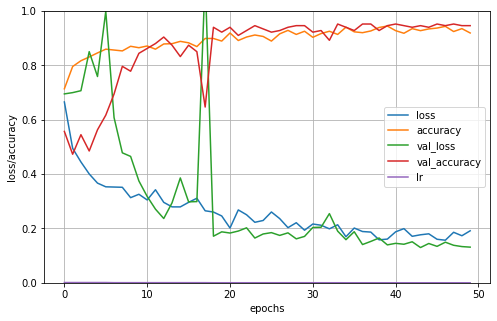

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

pd.DataFrame(history.history).plot(figsize=(8,5))
plt.grid(True)
plt.xlabel("epochs")
plt.ylabel('loss/accuracy')
plt.ylim(0,1)
plt.show()

In [ ]:
# Evaluate on test set
from sklearn.metrics import roc_curve, auc, accuracy_score
score = model.evaluate(X_test_scaled, y_test, verbose=1)
print('\nTest loss / accuracy: %0.4f / %0.4f'%(score[0], score[1]))
y_pred = model.predict(X_test_scaled)
fpr, tpr, _ = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)
print('Test ROC AUC:', roc_auc)

6/6 [==============================] - 2s 46ms/step - loss: 0.2463 - accuracy: 0.9261

Test loss / accuracy: 0.2463 / 0.9261
Test ROC AUC: 0.960956690368455


Now we try Exponential decay learning schedule

In [ ]:
tensorflow.keras.backend.clear_session()
model = Sequential([
        Conv2D(32, 5, activation='relu', padding='same', input_shape=X_train_scaled.shape[1:]),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(64, 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(128, 3, activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(256, 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(256, 3, activation='relu', padding='same'),
        BatchNormalization(),
        GlobalAveragePooling2D(),
        Flatten(),
        Dense(1024, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(256, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(1, activation='sigmoid' )
        ])
        
batch_size=16
s = 30*len(X_train_scaled)//batch_size
learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.001, s, 0.1)

model.compile(loss='binary_crossentropy',optimizer=Adamax(learning_schedule), metrics=['accuracy'])

history = model.fit(X_train_scaled, y_train, batch_size = 16,epochs =50, validation_split=0.15, verbose=0)


Visualizing the train and validation loss

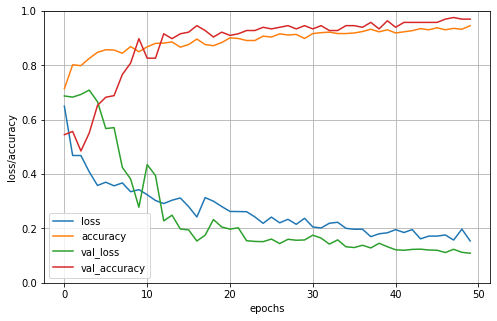

In [24]:
pd.DataFrame(history.history).plot(figsize=(8,5))
plt.grid(True)
plt.xlabel("epochs")
plt.ylabel('loss/accuracy')
plt.ylim(0,1)
plt.show()

In [25]:
# Evaluate on test set
from sklearn.metrics import roc_curve, auc, accuracy_score
score = model.evaluate(X_test_scaled, y_test, verbose=1)
print('\nTest loss / accuracy: %0.4f / %0.4f'%(score[0], score[1]))
y_pred = model.predict(X_test_scaled)
fpr, tpr, _ = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)
print('Test ROC AUC:', roc_auc)

6/6 [==============================] - 0s 46ms/step - loss: 0.2118 - accuracy: 0.9375

Test loss / accuracy: 0.2118 / 0.9375
Test ROC AUC: 0.9698771816418875


#### Tuning initial Learning rate

Since the exponentail decay learning schedule yields better results than the performance schedule (i.e. Reduceonplateau), so we proceed with the exponential decay and then tune the inital learning rate.

In [14]:
tensorflow.keras.backend.clear_session()

def build_model(lr0 = 0.001):
    model = Sequential([
    Conv2D(32, 5, activation='relu', padding='same', input_shape=X_train_scaled.shape[1:]),
    BatchNormalization(),
    MaxPooling2D(2),
    Conv2D(64, 3, activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(128, 3, activation='relu', padding='same'),
    BatchNormalization(),
    MaxPooling2D(2),
    Conv2D(256, 3, activation='relu', padding='same'),
    BatchNormalization(),
    Conv2D(256, 3, activation='relu', padding='same'),
    BatchNormalization(),
    GlobalAveragePooling2D(),
    Flatten(),
    Dense(1024, activation='relu'),
    BatchNormalization(),
    Dropout(0.3),
    Dense(256, activation='relu'),
    BatchNormalization(),
    Dropout(0.3),
    Dense(1, activation='sigmoid' )
    ])
    
    batch_size=16
    s = 30*len(X_train_scaled)//batch_size
    learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(lr0, s, 0.1)

    model.compile(loss='binary_crossentropy',optimizer=Adamax(learning_schedule), metrics=['accuracy'])
    
    return model

#wrapping the model within kerasClassifier
keras_classi_lr = tensorflow.keras.wrappers.scikit_learn.KerasClassifier(build_model)    

# parameter selection
param_distribs = {
    'lr0':np.arange(0.0001, 0.05, 0.0008).tolist()
    }

lr_search_cv = GridSearchCV(keras_classi_lr, param_distribs, cv=3)    

grid_result = lr_search_cv.fit(X_train_scaled, y_train, epochs=50, batch_size=16, verbose=0)

# summary results
print("Best: %f using %s" %(grid_result.best_score_, grid_result.best_params_))

means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" %(mean, stdev, param))

12/12 [==============================] - 1s 52ms/step - loss: 0.2633 - accuracy: 0.9024
Best: 0.922313 using {'lr0': 0.0009000000000000001}
0.899729 (0.010140) with: {'lr0': 0.0001}
0.922313 (0.015698) with: {'lr0': 0.0009000000000000001}
0.913279 (0.010140) with: {'lr0': 0.0017000000000000001}
0.898826 (0.011355) with: {'lr0': 0.0025}
0.919603 (0.010915) with: {'lr0': 0.0033}
0.906956 (0.006760) with: {'lr0': 0.0041}
0.909666 (0.008943) with: {'lr0': 0.004900000000000001}
0.898826 (0.005110) with: {'lr0': 0.0057}
0.918699 (0.002213) with: {'lr0': 0.006500000000000001}
0.921409 (0.015489) with: {'lr0': 0.007300000000000001}
0.906956 (0.015542) with: {'lr0': 0.0081}
0.920506 (0.018819) with: {'lr0': 0.0089}
0.907859 (0.015489) with: {'lr0': 0.0097}
0.883469 (0.024936) with: {'lr0': 0.0105}
0.905149 (0.021793) with: {'lr0': 0.0113}
0.882565 (0.005569) with: {'lr0': 0.0121}
0.880759 (0.003833) with: {'lr0': 0.0129}
0.906956 (0.013338) with: {'lr0': 0.0137}
0.878952 (0.053534) with: {'lr0'

### Training the model using the optimized parameter

In [17]:
tensorflow.keras.backend.clear_session()
model = Sequential([
        Conv2D(32, 5, activation='relu', padding='same', input_shape=X_train_scaled.shape[1:]),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(64, 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(128, 3, activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D(2),
        Conv2D(256, 3, activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(256, 3, activation='relu', padding='same'),
        BatchNormalization(),
        GlobalAveragePooling2D(),
        Flatten(),
        Dense(1024, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(256, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(1, activation='sigmoid' )
        ])
        
batch_size=16
s = 30*len(X_train_scaled)//batch_size
learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.0009, s, 0.1)

model.compile(loss='binary_crossentropy',optimizer=Adamax(learning_schedule), metrics=['accuracy'])
#model.summary()

# train the model
history = model.fit(X_train_scaled, y_train, batch_size = 16,epochs =50, validation_split=0.15)


Epoch 1/50
59/59 [==============================] - 9s 125ms/step - loss: 0.7709 - accuracy: 0.6645 - val_loss: 0.7012 - val_accuracy: 0.4790
Epoch 2/50
59/59 [==============================] - 5s 89ms/step - loss: 0.4544 - accuracy: 0.7985 - val_loss: 0.7693 - val_accuracy: 0.4790
Epoch 3/50
59/59 [==============================] - 5s 90ms/step - loss: 0.4236 - accuracy: 0.8112 - val_loss: 0.7682 - val_accuracy: 0.4790
Epoch 4/50
59/59 [==============================] - 5s 90ms/step - loss: 0.3914 - accuracy: 0.8315 - val_loss: 1.2440 - val_accuracy: 0.4790
Epoch 5/50
59/59 [==============================] - 5s 90ms/step - loss: 0.4518 - accuracy: 0.8256 - val_loss: 0.9626 - val_accuracy: 0.4910
Epoch 6/50
59/59 [==============================] - 5s 89ms/step - loss: 0.3705 - accuracy: 0.8520 - val_loss: 0.9762 - val_accuracy: 0.5749
Epoch 7/50
59/59 [==============================] - 5s 90ms/step - loss: 0.4032 - accuracy: 0.8310 - val_loss: 0.7262 - val_accuracy: 0.5808
Epoch 8/50
5

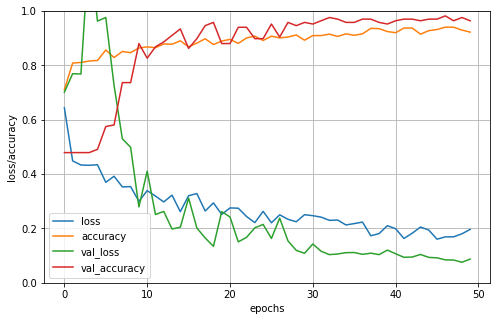

In [18]:
# visualizing the loss and accuracy
import pandas as pd
import matplotlib.pyplot as plt

pd.DataFrame(history.history).plot(figsize=(8,5))
plt.grid(True)
plt.xlabel("epochs")
plt.ylabel('loss/accuracy')
plt.ylim(0,1)
plt.show()

### Evaluating model using test images

#### Evaluation metrics

In [19]:

from sklearn.metrics import roc_curve, auc, accuracy_score, f1_score, precision_score, recall_score
score = model.evaluate(X_test_scaled, y_test, verbose=1)
print('\nTest loss / accuracy: %0.4f / %0.4f'%(score[0], score[1]))
y_pred = model.predict(X_test_scaled)
fpr, tpr, _ = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)
print('Test ROC AUC:', roc_auc)

y_pred_class = model.predict_classes(X_test_scaled)
print('Precision', precision_score(y_test,y_pred_class))
print('Recall', recall_score(y_test,y_pred_class))
print("F1_score", f1_score(y_test, y_pred_class))


6/6 [==============================] - 0s 50ms/step - loss: 0.2047 - accuracy: 0.9318

Test loss / accuracy: 0.2047 / 0.9318
Test ROC AUC: 0.9709114414996768


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


Precision 0.9195402298850575
Recall 0.9411764705882353
F1_score 0.9302325581395349


#### Display confusion matrix

In [65]:
def plot_confusion_matrix(cm, classes,
                        normalize=False,
                        title='Confusion matrix',
                        cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
            horizontalalignment="center",
            color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    
cm_plot_labels = ['Multi-phase', 'Single-phase']    

Confusion matrix, without normalization
[[84  7]
 [ 5 80]]


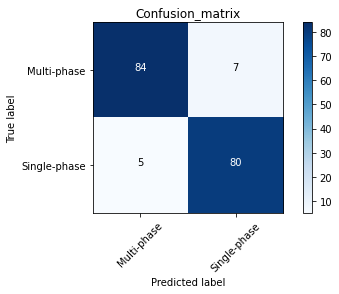

In [22]:
import itertools
from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_true=y_test, y_pred=y_pred_class)
plot_confusion_matrix(cm=cm, classes = cm_plot_labels, title='Confusion_matrix')

#### Display ROC curve

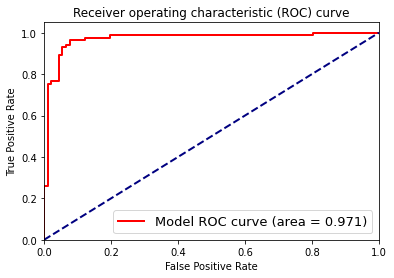

In [23]:
plt.figure()
lw = 2
plt.plot(fpr, tpr, color='red',
         lw=lw, label='Model ROC curve (area = %0.3f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic (ROC) curve')
plt.legend(loc="lower right", fontsize=13)
plt.show()

#### Model saving

In [25]:
model.save("Manual_model.h5")

## Trying the state-of-art architectures

### AlexNet

In [27]:

tensorflow.keras.backend.clear_session()

model = Sequential([
    Conv2D(96, 11, activation='relu', padding='valid', strides = 4, input_shape=X_train_scaled.shape[1:]),
    BatchNormalization(),
    MaxPooling2D(pool_size=(3,3), strides=2, padding='valid'),
    Conv2D(256, 5, activation='relu', strides=1, padding='same'),
    BatchNormalization(),
    MaxPooling2D(pool_size=(3,3), strides=2, padding='valid'),
    Conv2D(384, 3, activation='relu', strides=1, padding='same'),
    BatchNormalization(),
    Conv2D(384, 3, activation='relu', strides=1, padding='same'),
    BatchNormalization(),
    Conv2D(256, 3, activation='relu', strides=1, padding='same'),
    BatchNormalization(),
    MaxPooling2D(pool_size=(3,3), strides=2, padding='valid'),
    Flatten(),
    Dense(4096, activation='relu'),
    BatchNormalization(),
    Dense(4096, activation='relu'),
    BatchNormalization(),
    Dropout(0.5),
    Dense(100, activation='relu'),
    Dropout(0.5),
    Dense(1, activation='sigmoid' )
])

batch_size=16
s = 30*len(X_train)//batch_size
learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.0009, s, 0.1)

model.compile(loss='binary_crossentropy' ,optimizer=Adamax(learning_schedule), metrics=['accuracy'])

history_alex = model.fit(X_train_scaled, y_train, batch_size = 16,epochs =50, validation_split=0.15)



Epoch 1/50
59/59 [==============================] - 5s 50ms/step - loss: 1.5972 - accuracy: 0.6187 - val_loss: 2.1332 - val_accuracy: 0.5689
Epoch 2/50
59/59 [==============================] - 2s 37ms/step - loss: 0.9640 - accuracy: 0.7315 - val_loss: 1.7997 - val_accuracy: 0.6048
Epoch 3/50
59/59 [==============================] - 2s 37ms/step - loss: 0.9176 - accuracy: 0.7683 - val_loss: 1.6256 - val_accuracy: 0.6347
Epoch 4/50
59/59 [==============================] - 2s 37ms/step - loss: 0.5787 - accuracy: 0.7982 - val_loss: 1.9912 - val_accuracy: 0.6168
Epoch 5/50
59/59 [==============================] - 2s 37ms/step - loss: 0.6025 - accuracy: 0.8244 - val_loss: 1.0531 - val_accuracy: 0.6228
Epoch 6/50
59/59 [==============================] - 2s 37ms/step - loss: 0.4785 - accuracy: 0.8214 - val_loss: 0.8151 - val_accuracy: 0.6587
Epoch 7/50
59/59 [==============================] - 2s 37ms/step - loss: 0.4743 - accuracy: 0.8332 - val_loss: 0.6782 - val_accuracy: 0.7066
Epoch 8/50
59

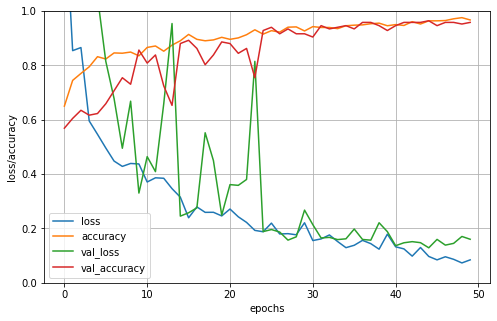

In [28]:

pd.DataFrame(history_alex.history).plot(figsize=(8,5))
plt.grid(True)
plt.xlabel("epochs")
plt.ylabel('loss/accuracy')
plt.ylim(0,1)
plt.show()

In [31]:
# Evaluate on test set
score = model.evaluate(X_test_scaled, y_test, verbose=1)
print('\nTest loss / accuracy: %0.4f / %0.4f'%(score[0], score[1]))
y_pred = model.predict(X_test_scaled)
fpr, tpr, _ = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)
print('Test ROC AUC:', roc_auc)

6/6 [==============================] - 1s 19ms/step - loss: 0.4781 - accuracy: 0.9034

Test loss / accuracy: 0.4781 / 0.9034
Test ROC AUC: 0.9515190691661279


The Alex model performance is poor as compared to the manual architecuture.

### RESNet

In [32]:
from functools import partial
DefaultConv2D = partial(Conv2D, kernel_size=3, strides=1,
                        padding="SAME", use_bias=False)

class ResidualUnit(tensorflow.keras.layers.Layer):
    def __init__(self, filters, strides=1, activation="relu", **kwargs):
        super().__init__(**kwargs)
        self.activation = tensorflow.keras.activations.get(activation)
        self.main_layers = [
            DefaultConv2D(filters, strides=strides),
            BatchNormalization(),
            self.activation,
            DefaultConv2D(filters),
            BatchNormalization()]
        self.skip_layers = []
        if strides > 1:
            self.skip_layers = [
                DefaultConv2D(filters, kernel_size=1, strides=strides),
                BatchNormalization()]

    def call(self, inputs):
        Z = inputs
        for layer in self.main_layers:
            Z = layer(Z)
        skip_Z = inputs
        for layer in self.skip_layers:
            skip_Z = layer(skip_Z)
        return self.activation(Z + skip_Z)

In [33]:
tensorflow.keras.backend.clear_session()

model = tensorflow.keras.models.Sequential()
model.add(DefaultConv2D(16, kernel_size=7, strides=2,
                        input_shape=X_train.shape[1:]))
model.add(BatchNormalization())
model.add(tensorflow.keras.layers.Activation("relu"))
model.add(MaxPooling2D(pool_size=3, strides=2, padding="SAME"))
prev_filters = 64
for filters in [16]*2 + [64] * 2 + [128] * 2 + [256]*2:
    strides = 1 if filters == prev_filters else 2
    model.add(ResidualUnit(filters, strides=strides))
    prev_filters = filters
model.add(GlobalAvgPool2D())
model.add(Flatten())
model.add(Dense(1024,activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.3)) 
model.add(Dense(256,activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.3))
model.add(Dense(1, activation="sigmoid"))


batch_size=16
s = 30*len(X_train_scaled)//batch_size
learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.0009, s, 0.1)

model.compile(loss='binary_crossentropy',optimizer=Adamax(learning_schedule), metrics=['accuracy'])

In [34]:
# train the model
history = model.fit(X_train_scaled, y_train, batch_size = 16, validation_split=0.15, epochs =50)

Epoch 1/50
59/59 [==============================] - 5s 36ms/step - loss: 0.7133 - accuracy: 0.6756 - val_loss: 0.7841 - val_accuracy: 0.4790
Epoch 2/50
59/59 [==============================] - 1s 24ms/step - loss: 0.5613 - accuracy: 0.7462 - val_loss: 0.8106 - val_accuracy: 0.4790
Epoch 3/50
59/59 [==============================] - 1s 24ms/step - loss: 0.3856 - accuracy: 0.8404 - val_loss: 1.2456 - val_accuracy: 0.4850
Epoch 4/50
59/59 [==============================] - 1s 24ms/step - loss: 0.3057 - accuracy: 0.8789 - val_loss: 0.7247 - val_accuracy: 0.5389
Epoch 5/50
59/59 [==============================] - 1s 24ms/step - loss: 0.2603 - accuracy: 0.9104 - val_loss: 0.7197 - val_accuracy: 0.5329
Epoch 6/50
59/59 [==============================] - 1s 24ms/step - loss: 0.1911 - accuracy: 0.9302 - val_loss: 0.5661 - val_accuracy: 0.6766
Epoch 7/50
59/59 [==============================] - 1s 24ms/step - loss: 0.2000 - accuracy: 0.9217 - val_loss: 0.9270 - val_accuracy: 0.6647
Epoch 8/50
59

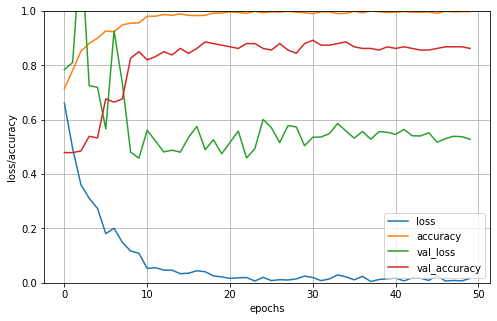

In [35]:

pd.DataFrame(history.history).plot(figsize=(8,5))
plt.grid(True)
plt.xlabel("epochs")
plt.ylabel('loss/accuracy')
plt.ylim(0,1)
plt.show()

ResNet is overfitting the data. One issue could be data being not sufficient. But since we have other models that performs much better, so we don't to spend time on solving the overfitting issue for this model.

### VGG 16 Model

In [19]:
class VGG16(Sequential):
    def __init__(self, input_shape):
        super().__init__()

        self.add(Conv2D(64, kernel_size=(3,3), padding= 'same',
                        activation= 'relu', input_shape= input_shape))
        self.add(Conv2D(64, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(MaxPooling2D(pool_size=(2,2), strides= (2,2)))

        self.add(Conv2D(128, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(Conv2D(128, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(MaxPooling2D(pool_size=(2,2), strides= (2,2)))

        self.add(Conv2D(256, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(Conv2D(256, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(Conv2D(256, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(Conv2D(256, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(MaxPooling2D(pool_size=(2,2), strides= (2,2)))

        self.add(Conv2D(512, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(Conv2D(512, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(Conv2D(512, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(Conv2D(512, kernel_size=(3,3), padding= 'same',
                        activation= 'relu'))
        self.add(GlobalAveragePooling2D())

        self.add(Flatten())
        self.add(Dense(1024, activation= 'relu'))
        self.add(Dropout(0.3))
        self.add(Dense(256, activation= 'relu'))
        self.add(Dropout(0.3))
        self.add(Dense(1, activation='sigmoid'))

        batch_size=16
        s = 30*len(X_train_scaled)//batch_size
        learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.0009, s, 0.1)

        self.compile(optimizer= Adamax(learning_schedule),
                    loss='binary_crossentropy',
                    metrics=['accuracy'])

In [20]:

model_VGG = VGG16((299, 299, 3))
history_vgg = model_VGG.fit(X_train_scaled, y_train, batch_size = 16,epochs =50, validation_split=0.15)

Epoch 1/50
59/59 [==============================] - 23s 295ms/step - loss: 0.6939 - accuracy: 0.4976 - val_loss: 0.6533 - val_accuracy: 0.4970
Epoch 2/50
59/59 [==============================] - 13s 226ms/step - loss: 0.6280 - accuracy: 0.6268 - val_loss: 0.6994 - val_accuracy: 0.4491
Epoch 3/50
59/59 [==============================] - 13s 226ms/step - loss: 0.5890 - accuracy: 0.6593 - val_loss: 0.5937 - val_accuracy: 0.7305
Epoch 4/50
59/59 [==============================] - 13s 226ms/step - loss: 0.5771 - accuracy: 0.7282 - val_loss: 0.6016 - val_accuracy: 0.7246
Epoch 5/50
59/59 [==============================] - 13s 225ms/step - loss: 0.5548 - accuracy: 0.7317 - val_loss: 0.5388 - val_accuracy: 0.7425
Epoch 6/50
59/59 [==============================] - 13s 225ms/step - loss: 0.4771 - accuracy: 0.7644 - val_loss: 0.4826 - val_accuracy: 0.8024
Epoch 7/50
59/59 [==============================] - 13s 225ms/step - loss: 0.4751 - accuracy: 0.7707 - val_loss: 0.4753 - val_accuracy: 0.7725

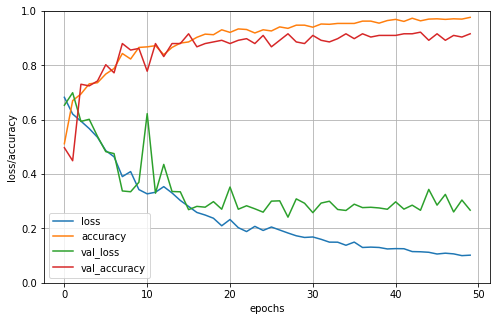

In [23]:
import pandas as pd
pd.DataFrame(history_vgg.history).plot(figsize=(8,5))
plt.grid(True)
plt.xlabel("epochs")
plt.ylabel('loss/accuracy')
plt.ylim(0,1)
plt.show()

VGG 16 also overfits the data. 

### Transfer Learning with InceptionV3

Pretrained InceptionV3 in ImageNet data

In [274]:
tensorflow.keras.backend.clear_session()
import keras
model = keras.applications.InceptionV3(weights = 'imagenet',include_top= False, input_shape=(299, 299, 3))
base_input = model.input
x = model.output
x = GlobalAvgPool2D()(x)
x = Dense(1024, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.3)(x)
x = Dense(256, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.3)(x)
final_outputs = Dense(1, activation='sigmoid')(x)
new_model = keras.Model(inputs = base_input, outputs = final_outputs)
#new_model.summary()

In [275]:
# first we freeze all the convulational InceptionV3 layers
for layer in model.layers:
  layer.trainable = False

In [276]:
batch_size=16
s = 30*len(X_train)//batch_size
learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.001, s, 0.1)

new_model.compile(loss='binary_crossentropy',optimizer=Adam(learning_schedule), metrics=['accuracy'])

In [277]:
history = new_model.fit(X_train_scaled, y_train, batch_size = 16,epochs =10, validation_split=0.15)

Epoch 1/10
59/59 [==============================] - 10s 89ms/step - loss: 0.4257 - accuracy: 0.8460 - val_loss: 0.2700 - val_accuracy: 0.8982
Epoch 2/10
59/59 [==============================] - 3s 55ms/step - loss: 0.1091 - accuracy: 0.9581 - val_loss: 0.5083 - val_accuracy: 0.8623
Epoch 3/10
59/59 [==============================] - 3s 55ms/step - loss: 0.0941 - accuracy: 0.9635 - val_loss: 0.1578 - val_accuracy: 0.9521
Epoch 4/10
59/59 [==============================] - 3s 55ms/step - loss: 0.0928 - accuracy: 0.9684 - val_loss: 0.1471 - val_accuracy: 0.9581
Epoch 5/10
59/59 [==============================] - 3s 55ms/step - loss: 0.0949 - accuracy: 0.9709 - val_loss: 0.1337 - val_accuracy: 0.9521
Epoch 6/10
59/59 [==============================] - 3s 55ms/step - loss: 0.0350 - accuracy: 0.9857 - val_loss: 0.1819 - val_accuracy: 0.9641
Epoch 7/10
59/59 [==============================] - 3s 55ms/step - loss: 0.0466 - accuracy: 0.9827 - val_loss: 0.2068 - val_accuracy: 0.9581
Epoch 8/10
5

In [278]:
# evaluation on test images
from sklearn.metrics import roc_curve, auc, accuracy_score, f1_score, precision_score, recall_score
score = new_model.evaluate(X_test_scaled, y_test, verbose=1)
print('\nTest loss / accuracy: %0.4f / %0.4f'%(score[0], score[1]))
y_pred = new_model.predict(X_test_scaled)
fpr, tpr, _ = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)
print('Test ROC AUC:', roc_auc)

y_pred = new_model.predict(X_test_scaled)
y_pred_class = (y_pred >0.5).astype(int)  # for binary class_mode
y_pred_class = y_pred_class[:,0]

print('Precision', precision_score(y_test,y_pred_class))
print('Recall', recall_score(y_test,y_pred_class))
print("F1_score", f1_score(y_test, y_pred_class))

6/6 [==============================] - 0s 68ms/step - loss: 0.2196 - accuracy: 0.9545

Test loss / accuracy: 0.2196 / 0.9545
Test ROC AUC: 0.9819004524886877
Precision 0.9873417721518988
Recall 0.9176470588235294
F1_score 0.9512195121951219


 Making the top two convolution layers trainable

In [298]:
model.get_layer('conv2d_93').trainable= True
model.get_layer('conv2d_85').trainable=True
model.get_layer('conv2d_92').trainable=True

In [299]:
batch_size=16
s = 30*len(X_train)//batch_size
learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.001, s, 0.1)

new_model.compile(loss='binary_crossentropy',optimizer=Adam(learning_schedule), metrics=['accuracy'])

In [300]:
history = new_model.fit(X_train_scaled, y_train, batch_size = 16,epochs =20, validation_split=0.15, callbacks=[tensorflow.keras.callbacks.EarlyStopping(patience=10)])

Epoch 1/20
59/59 [==============================] - 10s 89ms/step - loss: 0.0323 - accuracy: 0.9862 - val_loss: 0.1900 - val_accuracy: 0.9581
Epoch 2/20
59/59 [==============================] - 3s 56ms/step - loss: 0.0353 - accuracy: 0.9824 - val_loss: 0.5775 - val_accuracy: 0.8862
Epoch 3/20
59/59 [==============================] - 3s 56ms/step - loss: 0.0507 - accuracy: 0.9842 - val_loss: 0.1241 - val_accuracy: 0.9641
Epoch 4/20
59/59 [==============================] - 3s 56ms/step - loss: 0.0150 - accuracy: 0.9975 - val_loss: 0.1517 - val_accuracy: 0.9641
Epoch 5/20
59/59 [==============================] - 3s 55ms/step - loss: 0.0067 - accuracy: 0.9970 - val_loss: 0.1806 - val_accuracy: 0.9760
Epoch 6/20
59/59 [==============================] - 3s 56ms/step - loss: 0.0145 - accuracy: 0.9944 - val_loss: 0.2001 - val_accuracy: 0.9581
Epoch 7/20
59/59 [==============================] - 3s 56ms/step - loss: 0.0067 - accuracy: 0.9979 - val_loss: 0.2268 - val_accuracy: 0.9581
Epoch 8/20
5

In [301]:
# evaluation on test images
from sklearn.metrics import roc_curve, auc, accuracy_score, f1_score, precision_score, recall_score
score = new_model.evaluate(X_test_scaled, y_test, verbose=1)
print('\nTest loss / accuracy: %0.4f / %0.4f'%(score[0], score[1]))
y_pred = new_model.predict(X_test_scaled)
fpr, tpr, _ = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)
print('Test ROC AUC:', roc_auc)

y_pred = new_model.predict(X_test_scaled)
y_pred_class = (y_pred >0.5).astype(int)  # for binary class_mode
y_pred_class = y_pred_class[:,0]

print('Precision', precision_score(y_test,y_pred_class))
print('Recall', recall_score(y_test,y_pred_class))
print("F1_score", f1_score(y_test, y_pred_class))

6/6 [==============================] - 0s 68ms/step - loss: 0.1583 - accuracy: 0.9659

Test loss / accuracy: 0.1583 / 0.9659
Test ROC AUC: 0.9939237233354881
Precision 0.9759036144578314
Recall 0.9529411764705882
F1_score 0.9642857142857143


Confusion matrix, without normalization
[[89  2]
 [ 4 81]]


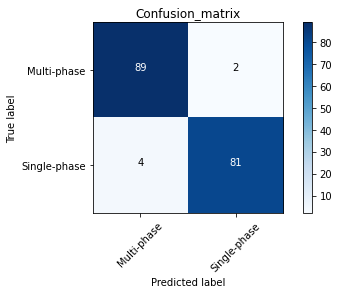

In [302]:
import itertools
from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_true=y_test, y_pred=y_pred_class)
plot_confusion_matrix(cm=cm, classes = cm_plot_labels, title='Confusion_matrix')

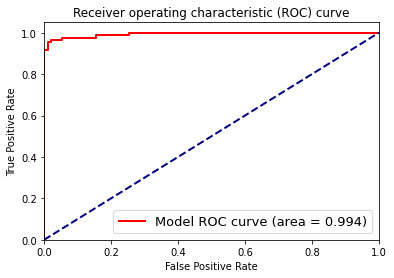

In [303]:
plt.figure()
lw = 2
plt.plot(fpr, tpr, color='red',
         lw=lw, label='Model ROC curve (area = %0.3f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic (ROC) curve')
plt.legend(loc="lower right", fontsize=13)
plt.show()

In [305]:
new_model.save("inceptionV3_transfer.h5")

Visualize images with actual and predicted labels

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 9 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 9 missing from current font.
  font.set_text(s, 0, flags=flags)


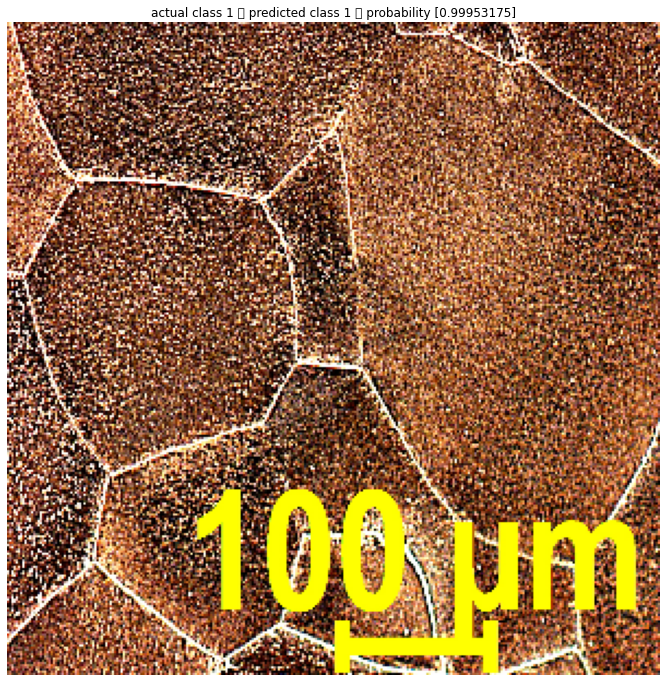

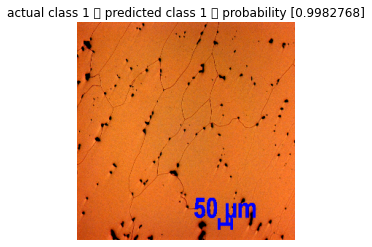

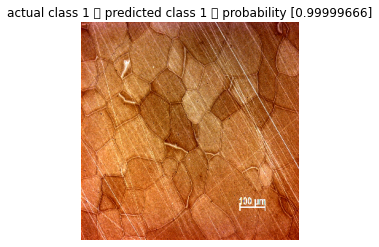

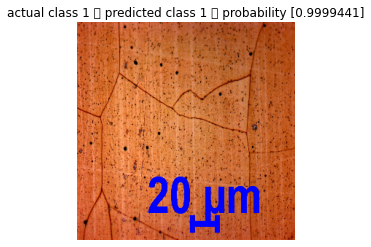

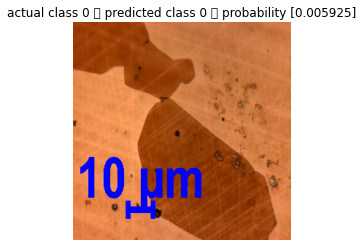

...

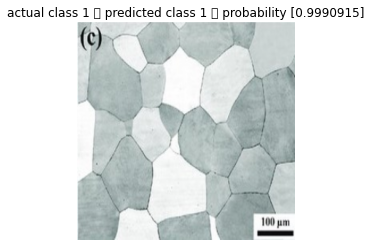

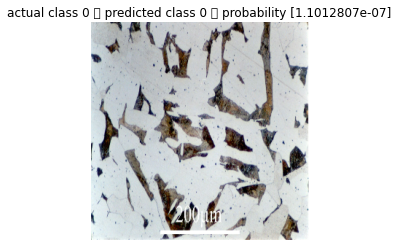

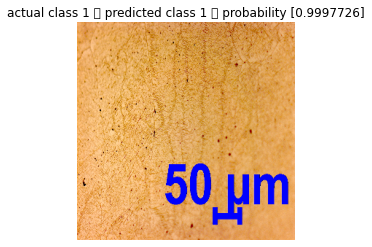

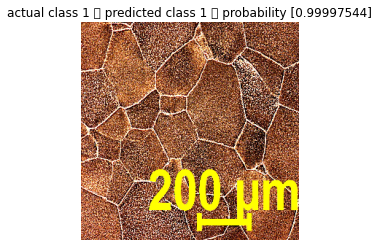

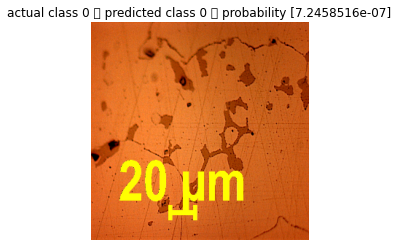

In [306]:
plt.figure(figsize=(12,12))
index=0
for img in X_test:
    plt.imshow(img)
    plt.title("actual class {} \t predicted class {} \t probability {}".format(y_test[index], y_pred_class[index], y_pred[index]))
    index +=1
    plt.axis("off")
    plt.show()

### Transfer learning with VGG16

Since this takes input image of size 224 x 224, let's create dataset so that the images will have 224 x 224 shape.

In [89]:
# training data
DATADIR = "./Train"
CATEGORIES = ['Multiple-Phase', 'Single-Phase']

training_data = []

IMG_SIZE = 224  # image size we want

def create_training_data():
    for category in CATEGORIES:
        path = os.path.join(DATADIR, category)
        class_num = CATEGORIES.index(category)
        for img in os.listdir(path):
            im = cv2.imread(os.path.join(path,img)) 
            img_array = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)   # if using BGR and Grayscale comment this
            new_array = cv2.resize(img_array, (IMG_SIZE, IMG_SIZE))
            training_data.append([new_array, class_num])
            
create_training_data()   

random.shuffle(training_data)

photos = []
labels = []

for features, label in training_data:
    photos.append(features)
    labels.append(label)
    
X_train= np.array(photos).reshape(-1, IMG_SIZE, IMG_SIZE, 3)  # for gray scale 1, for RBG change it to 3   
y_train = np.array(labels) 


In [90]:
# test data
DATADIR = "./Test"
CATEGORIES = ['Multiple-Phase', 'Single-Phase']

test_data = []


def create_test_data():
    for category in CATEGORIES:
        path = os.path.join(DATADIR, category)
        class_num = CATEGORIES.index(category)
        for img in os.listdir(path):
            im = cv2.imread(os.path.join(path,img))
            img_array = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
            new_array = cv2.resize(img_array, (IMG_SIZE, IMG_SIZE))
            test_data.append([new_array, class_num])
            
create_test_data()  

random.shuffle(test_data)

# Creating feature matrix and labels
feature_test = []
labels_test = []


for features, label in test_data:
    feature_test.append(features)
    labels_test.append(label)
    
X_test= np.array(feature_test).reshape(-1, IMG_SIZE, IMG_SIZE, 3)  # for gray scale 1, for RBG change it to 3 
y_test = np.array(labels_test)


In [106]:
# scaling the train and test data pixel values
X_train_scaled = X_train/ 255.

X_test_scaled = X_test/ 255.

In [184]:
tensorflow.keras.backend.clear_session()
from keras.applications.vgg16 import VGG16
model = VGG16(include_top = False, input_shape=(224, 224, 3))
# adding custom dense layers
flat1 = Flatten()(model.layers[-1].output)
dense1 = Dense(1024, activation='relu')(flat1)
drop1 = Dropout(0.3)(dense1)
dense2 = Dense(256, activation='relu')(drop1)
drop2 = Dropout(0.3)(dense2)
final_output = Dense(1, activation='sigmoid')(drop2)

new_model = Model(inputs = model.inputs, outputs = final_output)

#new_model.summary()

In [185]:
for layer in model.layers:
  layer.trainable = False

In [186]:
batch_size=16
s = 30*len(X_train)//batch_size
learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.001, s, 0.1)

new_model.compile(loss='binary_crossentropy',optimizer=Adamax(learning_schedule), metrics=['accuracy'])


In [187]:
history = new_model.fit(X_train_scaled, y_train, batch_size = 16,epochs =20, validation_split=0.15)

Epoch 1/20
59/59 [==============================] - 4s 52ms/step - loss: 1.0106 - accuracy: 0.7143 - val_loss: 0.2549 - val_accuracy: 0.8922
Epoch 2/20
59/59 [==============================] - 3s 46ms/step - loss: 0.3866 - accuracy: 0.8716 - val_loss: 0.2277 - val_accuracy: 0.9281
Epoch 3/20
59/59 [==============================] - 3s 46ms/step - loss: 0.2145 - accuracy: 0.9096 - val_loss: 0.1775 - val_accuracy: 0.9281
Epoch 4/20
59/59 [==============================] - 3s 46ms/step - loss: 0.1572 - accuracy: 0.9432 - val_loss: 0.2326 - val_accuracy: 0.9341
Epoch 5/20
59/59 [==============================] - 3s 46ms/step - loss: 0.1589 - accuracy: 0.9409 - val_loss: 0.1629 - val_accuracy: 0.9401
Epoch 6/20
59/59 [==============================] - 3s 46ms/step - loss: 0.1163 - accuracy: 0.9559 - val_loss: 0.1519 - val_accuracy: 0.9401
Epoch 7/20
59/59 [==============================] - 3s 46ms/step - loss: 0.1222 - accuracy: 0.9471 - val_loss: 0.1860 - val_accuracy: 0.9401
Epoch 8/20
59

In [188]:
# evaluation on test images
score = new_model.evaluate(X_test_scaled, y_test, verbose=1)
print('\nTest loss / accuracy: %0.4f / %0.4f'%(score[0], score[1]))
y_pred = new_model.predict(X_test_scaled)
fpr, tpr, _ = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)
print('Test ROC AUC:', roc_auc)

y_pred = new_model.predict(X_test_scaled)
y_pred_class = (y_pred >0.5).astype(int)  # for binary class_mode
y_pred_class = y_pred_class[:,0]

print('Precision', precision_score(y_test,y_pred_class))
print('Recall', recall_score(y_test,y_pred_class))
print("F1_score", f1_score(y_test, y_pred_class))

6/6 [==============================] - 0s 59ms/step - loss: 0.2107 - accuracy: 0.9261

Test loss / accuracy: 0.2107 / 0.9261
Test ROC AUC: 0.9843568196509374
Precision 0.95
Recall 0.8941176470588236
F1_score 0.9212121212121211


Confusion matrix, without normalization
[[87  4]
 [ 9 76]]


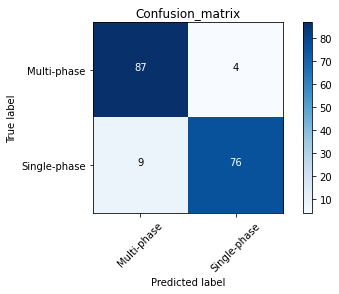

In [189]:
import itertools
from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_true=y_test, y_pred=y_pred_class)
plot_confusion_matrix(cm=cm, classes = cm_plot_labels, title='Confusion_matrix')

Let's train last convolution layer

In [190]:
#model.get_layer('block5_conv1').trainable= True
model.get_layer('block5_conv2').trainable=True
model.get_layer('block5_conv3').trainable=True

In [191]:
batch_size=16
s = 30*len(X_train)//batch_size
learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.001, s, 0.1)

new_model.compile(loss='binary_crossentropy',optimizer=Adamax(learning_schedule), metrics=['accuracy'])

In [192]:
history = new_model.fit(X_train_scaled, y_train, batch_size = 16,epochs =30, validation_split=0.15, callbacks = [tensorflow.keras.callbacks.EarlyStopping(patience=10)])

Epoch 1/30
59/59 [==============================] - 4s 54ms/step - loss: 2.3259 - accuracy: 0.7832 - val_loss: 0.2005 - val_accuracy: 0.9222
Epoch 2/30
59/59 [==============================] - 3s 50ms/step - loss: 0.2571 - accuracy: 0.9040 - val_loss: 0.2092 - val_accuracy: 0.9162
Epoch 3/30
59/59 [==============================] - 3s 49ms/step - loss: 0.1855 - accuracy: 0.9444 - val_loss: 0.1392 - val_accuracy: 0.9521
Epoch 4/30
59/59 [==============================] - 3s 50ms/step - loss: 0.1495 - accuracy: 0.9393 - val_loss: 0.1406 - val_accuracy: 0.9521
Epoch 5/30
59/59 [==============================] - 3s 49ms/step - loss: 0.0995 - accuracy: 0.9622 - val_loss: 0.1555 - val_accuracy: 0.9521
Epoch 6/30
59/59 [==============================] - 3s 49ms/step - loss: 0.0793 - accuracy: 0.9730 - val_loss: 0.1371 - val_accuracy: 0.9581
Epoch 7/30
59/59 [==============================] - 3s 49ms/step - loss: 0.0712 - accuracy: 0.9686 - val_loss: 0.1167 - val_accuracy: 0.9641
Epoch 8/30
59

In [193]:
# evaluation on test images
score = new_model.evaluate(X_test_scaled, y_test, verbose=1)
print('\nTest loss / accuracy: %0.4f / %0.4f'%(score[0], score[1]))
y_pred = new_model.predict(X_test_scaled)
fpr, tpr, _ = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)
print('Test ROC AUC:', roc_auc)

y_pred = new_model.predict(X_test_scaled)
y_pred_class = (y_pred >0.5).astype(int)  # for binary class_mode
y_pred_class = y_pred_class[:,0]

print('Precision', precision_score(y_test,y_pred_class))
print('Recall', recall_score(y_test,y_pred_class))
print("F1_score", f1_score(y_test, y_pred_class))

6/6 [==============================] - 0s 60ms/step - loss: 0.1467 - accuracy: 0.9489

Test loss / accuracy: 0.1467 / 0.9489
Test ROC AUC: 0.994311570782159
Precision 0.9418604651162791
Recall 0.9529411764705882
F1_score 0.9473684210526314


Confusion matrix, without normalization
[[86  5]
 [ 4 81]]


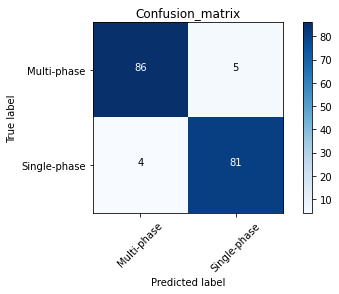

In [194]:
import itertools
from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_true=y_test, y_pred=y_pred_class)
plot_confusion_matrix(cm=cm, classes = cm_plot_labels, title='Confusion_matrix')

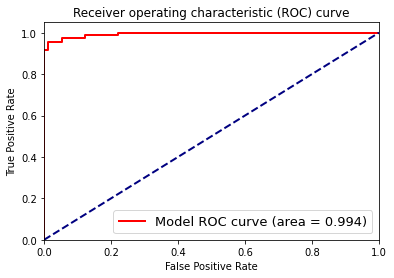

In [195]:
plt.figure()
lw = 2
plt.plot(fpr, tpr, color='red',
         lw=lw, label='Model ROC curve (area = %0.3f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic (ROC) curve')
plt.legend(loc="lower right", fontsize=13)
plt.show()

In [196]:
new_model.save("vgg16_transfer.h5")

The VGG model performs well, however, it couldn't beat the InceptionV3.

### Transfer learning with ResNet50.

In [160]:
tensorflow.keras.backend.clear_session()
from keras.applications.resnet50 import ResNet50
resnet_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
base_input = resnet_model.input
x = resnet_model.output
x = GlobalAvgPool2D()(x)
x = Dense(1024, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.3)(x)
x = Dense(256, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.3)(x)
final_outputs = Dense(1, activation='sigmoid')(x)
new_model = keras.Model(inputs = base_input, outputs = final_outputs)
#new_model.summary()

In [161]:
for layer in resnet_model.layers:
    layer.trainable = False

In [166]:
batch_size=16
s = 30*len(X_train)//batch_size
learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.001, s, 0.1)

new_model.compile(loss='binary_crossentropy',optimizer=Adamax(learning_schedule), metrics=['accuracy'])

In [167]:
history = new_model.fit(X_train_scaled, y_train, batch_size = 16,epochs =50, validation_split=0.15, callbacks = [tensorflow.keras.callbacks.EarlyStopping(patience=15)])

Epoch 1/50
59/59 [==============================] - 7s 59ms/step - loss: 0.2191 - accuracy: 0.9038 - val_loss: 1.9051 - val_accuracy: 0.5509
Epoch 2/50
59/59 [==============================] - 2s 41ms/step - loss: 0.2203 - accuracy: 0.9188 - val_loss: 0.7127 - val_accuracy: 0.7246
Epoch 3/50
59/59 [==============================] - 2s 41ms/step - loss: 0.2057 - accuracy: 0.9178 - val_loss: 1.2410 - val_accuracy: 0.6407
Epoch 4/50
59/59 [==============================] - 2s 41ms/step - loss: 0.2319 - accuracy: 0.9156 - val_loss: 0.8430 - val_accuracy: 0.7066
Epoch 5/50
59/59 [==============================] - 2s 41ms/step - loss: 0.2449 - accuracy: 0.9056 - val_loss: 0.2868 - val_accuracy: 0.8982
Epoch 6/50
59/59 [==============================] - 2s 41ms/step - loss: 0.1783 - accuracy: 0.9412 - val_loss: 0.3836 - val_accuracy: 0.8263
Epoch 7/50
59/59 [==============================] - 2s 41ms/step - loss: 0.2081 - accuracy: 0.9226 - val_loss: 0.4605 - val_accuracy: 0.8144
Epoch 8/50
59

In [168]:
# evaluation on test images
score = new_model.evaluate(X_test_scaled, y_test, verbose=1)
print('\nTest loss / accuracy: %0.4f / %0.4f'%(score[0], score[1]))
y_pred = new_model.predict(X_test_scaled)
fpr, tpr, _ = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)
print('Test ROC AUC:', roc_auc)

y_pred = new_model.predict(X_test_scaled)
y_pred_class = (y_pred >0.5).astype(int)  # for binary class_mode
y_pred_class = y_pred_class[:,0]

print('Precision', precision_score(y_test,y_pred_class))
print('Recall', recall_score(y_test,y_pred_class))
print("F1_score", f1_score(y_test, y_pred_class))

6/6 [==============================] - 0s 53ms/step - loss: 0.5758 - accuracy: 0.8636

Test loss / accuracy: 0.5758 / 0.8636
Test ROC AUC: 0.8833872010342598
Precision 0.8588235294117647
Recall 0.8588235294117647
F1_score 0.8588235294117647


In [170]:
# training the top convoluation layer
resnet_model.get_layer('conv5_block3_3_conv').trainable=True

In [171]:
batch_size=16
s = 30*len(X_train)//batch_size
learning_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(0.001, s, 0.1)

model.compile(loss='binary_crossentropy',optimizer=Adamax(learning_schedule), metrics=['accuracy'])

In [172]:
history = model.fit(X_train_scaled, y_train, batch_size = 16,epochs =50, validation_split=0.15, callbacks = [tensorflow.keras.callbacks.EarlyStopping(patience=15)])

Epoch 1/50
59/59 [==============================] - 7s 58ms/step - loss: 0.3769 - accuracy: 0.8360 - val_loss: 0.3931 - val_accuracy: 0.8383
Epoch 2/50
59/59 [==============================] - 2s 40ms/step - loss: 0.3325 - accuracy: 0.8538 - val_loss: 0.4178 - val_accuracy: 0.8623
Epoch 3/50
59/59 [==============================] - 2s 41ms/step - loss: 0.3686 - accuracy: 0.8124 - val_loss: 0.4594 - val_accuracy: 0.7964
Epoch 4/50
59/59 [==============================] - 2s 42ms/step - loss: 0.3022 - accuracy: 0.8580 - val_loss: 0.4204 - val_accuracy: 0.7964
Epoch 5/50
59/59 [==============================] - 2s 41ms/step - loss: 0.3117 - accuracy: 0.8481 - val_loss: 0.4159 - val_accuracy: 0.8383
Epoch 6/50
59/59 [==============================] - 2s 41ms/step - loss: 0.3158 - accuracy: 0.8765 - val_loss: 0.4151 - val_accuracy: 0.8683
Epoch 7/50
59/59 [==============================] - 2s 41ms/step - loss: 0.3538 - accuracy: 0.8469 - val_loss: 0.4109 - val_accuracy: 0.8683
Epoch 8/50
59

In [173]:
# evaluation on test images
score = new_model.evaluate(X_test_scaled, y_test, verbose=1)
print('\nTest loss / accuracy: %0.4f / %0.4f'%(score[0], score[1]))
y_pred = new_model.predict(X_test_scaled)
fpr, tpr, _ = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)
print('Test ROC AUC:', roc_auc)

y_pred = new_model.predict(X_test_scaled)
y_pred_class = (y_pred >0.5).astype(int)  # for binary class_mode
y_pred_class = y_pred_class[:,0]

print('Precision', precision_score(y_test,y_pred_class))
print('Recall', recall_score(y_test,y_pred_class))
print("F1_score", f1_score(y_test, y_pred_class))

6/6 [==============================] - 0s 55ms/step - loss: 0.5758 - accuracy: 0.8636

Test loss / accuracy: 0.5758 / 0.8636
Test ROC AUC: 0.8833872010342598
Precision 0.8588235294117647
Recall 0.8588235294117647
F1_score 0.8588235294117647


Confusion matrix, without normalization
[[79 12]
 [12 73]]


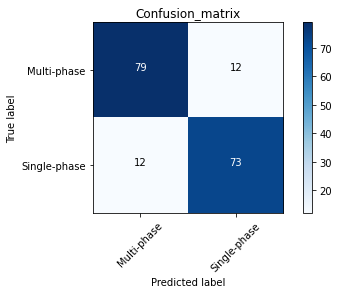

In [174]:
import itertools
from sklearn.metrics import confusion_matrix

cm = confusion_matrix(y_true=y_test, y_pred=y_pred_class)
plot_confusion_matrix(cm=cm, classes = cm_plot_labels, title='Confusion_matrix')